# Lesson 6 - Introduction to persistent homology

> A first look at persistent homology, the workhorse underlying topological machine learning.

[![Binder](https://mybinder.org/badge_logo.svg)](https://mybinder.org/v2/gh/lewtun/hepml/master?urlpath=lab/tree/notebooks%2Flesson06_persistent-homology.ipynb) [![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/lewtun/hepml/blob/master/notebooks/lesson06_persistent-homology.ipynb)

## Learning objectives

## References

* [_Persistent Homology: A Non-Mathy Introduction with Examples_](https://towardsdatascience.com/persistent-homology-with-examples-1974d4b9c3d0) by G. Koplik
* Chapter 2 of [An Introduction to Topological Data Analysis for Physicists: From LGM to FRBs]
* Getting Started with Giotto-tda

## What is persistent homology?

In general terms, persistent homology focuses on answering the question

> As one increases a threshold, at what scale do we observe changes in some geometric representation of the data?

The answer to this question involves [deep mathematics](https://arxiv.org/abs/1710.04019) and will not be covered 
here. Perhaps the simplest way to understand persistent homology is in terms of _growing balls around each point._ The basic idea is that by keeping track of when the balls intersect we can quantify when topological features like connected components and loops are "born" or "die".

### 0-dimensional persistent homology

For example, consider two noisy clusters and track their connectivity or "0-dimensional persistent homology" as we increase the radius of the balls around each point:

![](images/persistent_homology_0d.gif)

As the ball radius is grown from 0 to infinity, 0-dimensional persistent homology records when the ball in one connected component first intersects a ball of a _different_ connected component (denoted by a different colour in the animation).  At radius 0, a connected component for each point is _born_ and once any two balls touch we have a _death_ of a connected component with one color persisting and the other color vanishing. Each color vanishing corresponds to a death and therefore another point being added to the persistence diagram.

Referece

### 1-dimensional persistent homology

With 1-dimensional persistent homology, we still blow up balls around points but instead of tracking connected components, we track the birth and death of _loops_. Consider for example the visualisation below:

![](images/persistent_homology_1d.gif)

Note that in this example a persistent loop is born around a radius of 0.25 and dies arouns 0.6, giving rise to the outlier in the persistence diagram.

### n-dimensional persistent homology

The above discussion generalises to higher dimensions, where instead we just grow hyperspheres instead of balls and look for the birth and death of multidimensional voids.

## Import libraries

In [ ]:
%load_ext autoreload
%autoreload 2

In [ ]:
# data wrangling
import numpy as np
import pandas as pd
from pathlib import Path

# tda magic
from gtda.homology import VietorisRipsPersistence
from gtda.diagrams import PersistenceEntropy
from gtda.plotting import *

# ml tools
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score, train_test_split

# dataviz
import matplotlib.pyplot as plt

In [ ]:
def make_point_clouds(n_samples_per_shape, n_points, noise):
    circle_point_clouds = [
        np.asarray(
            [
                [np.sin(t) + noise * (np.random.rand(1)[0] - 0.5), np.cos(t) + noise * (np.random.rand(1)[0] - 0.5), 0]
                for t in range((n_points ** 2))
            ]
        )
        for kk in range(n_samples_per_shape)
    ]
    # label circles with 0
    circle_labels = np.zeros(n_samples_per_shape)

    sphere_point_clouds = [
        np.asarray(
            [
                [
                    np.cos(s) * np.cos(t) + noise * (np.random.rand(1)[0] - 0.5),
                    np.cos(s) * np.sin(t) + noise * (np.random.rand(1)[0] - 0.5),
                    np.sin(s) + noise * (np.random.rand(1)[0] - 0.5),
                ]
                for t in range(n_points)
                for s in range(n_points)
            ]
        )
        for kk in range(n_samples_per_shape)
    ]
    # label spheres with 1
    sphere_labels = np.ones(n_samples_per_shape)

    torus_point_clouds = [
        np.asarray(
            [
                [
                    (2 + np.cos(s)) * np.cos(t) + noise * (np.random.rand(1)[0] - 0.5),
                    (2 + np.cos(s)) * np.sin(t) + noise * (np.random.rand(1)[0] - 0.5),
                    np.sin(s) + noise * (np.random.rand(1)[0] - 0.5),
                ]
                for t in range(n_points)
                for s in range(n_points)
            ]
        )
        for kk in range(n_samples_per_shape)
    ]
    # label tori with 2
    torus_labels = 2 * np.ones(n_samples_per_shape)

    point_clouds = np.concatenate((circle_point_clouds, sphere_point_clouds, torus_point_clouds))
    labels = np.concatenate((circle_labels, sphere_labels, torus_labels))

    return point_clouds, labels

## 3D shape classification

<div style="text-align: center">
<img src='images/semantic-ptcl.gif' width='800'>
   <p style="text-align: center;"> <b>Figure reference:</b> https://pythonawesome.com/semantic-and-instance-segmentation-of-lidar-point-clouds-for-autonomous-driving/ </p>
</div>

Techniques for analyzing 3D shapes are becoming increasingly important due to the vast number of sensors such as LiDAR that are capturing 3D data, as well as numerous computer graphics applications.  These raw data are typically collected in the form of a _point cloud_, which corresponds to a set of 3D points $\{p_i | i = 1, \ldots, n\}$, where each point $p_i$ is a vector of its $(x, y, z)$ coordinates plus extra
feature channels such as color, intensity etc. Typically Euclidean distance is used to calculate the distances between any two points.

By finding suitable representations of these point clouds, machine learning can be used to solve a variety of tasks such as those shown in the figure below.

<div style="text-align: center">
<img src='images/3d-tasks.png'>
   <p style="text-align: center;"> <b>Figure reference:</b> adapted from https://arxiv.org/abs/1612.00593 </p>
</div>

### Generate simple shapes

To get started, let's generate a synthetic dataset of noisy circles, spheres, and torii, where the effect of noise is to displace the points sampling the surfaces by a random amount in a random direction:

In [ ]:
point_clouds, labels = make_point_clouds(n_samples_per_shape=10, n_points=20, noise=0.5)

In [ ]:
point_clouds.shape, labels.shape

((30, 400, 3), (30,))

Here the labels are chosen to that a circle is 0, a sphere is 1, and a torus is 2. Each point cloud corresponds to a sampling of the continuous surface - in this case 400 points are sampled per sphere or torus. As a sanity check, let's visualise these points clouds:

In [ ]:
# expect circle
plot_point_cloud(point_clouds[0])

In [ ]:
# expect sphere
plot_point_cloud(point_clouds[10])

In [ ]:
# expect torus
plot_point_cloud(point_clouds[-1])

### From data to persistence diagrams
In raw form, point cloud data is not well suited for most machine learning algorithms because we ultimately need a _feature matrix_ $X$ where each row corresponds to a single sample (i.e. point cloud) and each column corresponds to a particular feature. In our example, each point cloud corresponds to a _collection_ of 3-dimensional vectors, so we need some way of representing this information in terms of a _single_ vector $x^{(i)}$ of feature values.

In this lesson we will use persistent homology to generate a topological summary of a point cloud in the form of a so-called persistence diagram.

In [ ]:
# track connected components, loops, and voids
homology_dimensions = [0, 1, 2]

# calculating persistence is memory intensive - adjust n_jobs according to how many cores you have!
persistence = VietorisRipsPersistence(metric="euclidean", homology_dimensions=homology_dimensions, n_jobs=6)

%time persistence_diagrams = persistence.fit_transform(point_clouds)

CPU times: user 90 ms, sys: 49.1 ms, total: 139 ms
Wall time: 1min 11s


Once we have computed our persistence diagrams, we can compare how the circle, sphere and torus produce different patterns at each homology dimension:

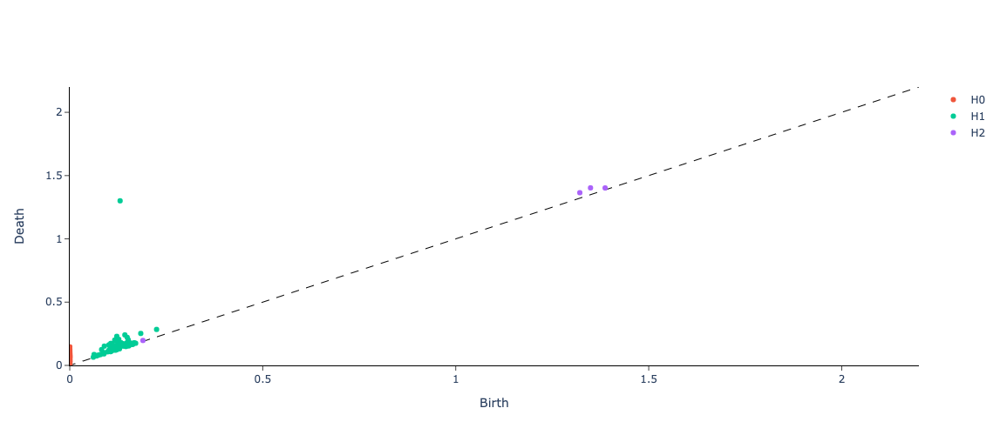

In [ ]:
# circle
plot_diagram(persistence_diagrams[0])

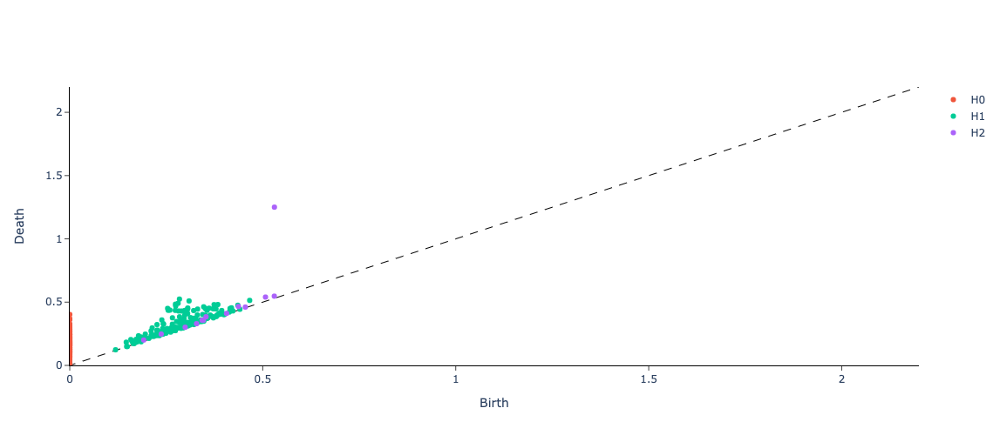

In [ ]:
# sphere
plot_diagram(persistence_diagrams[10])

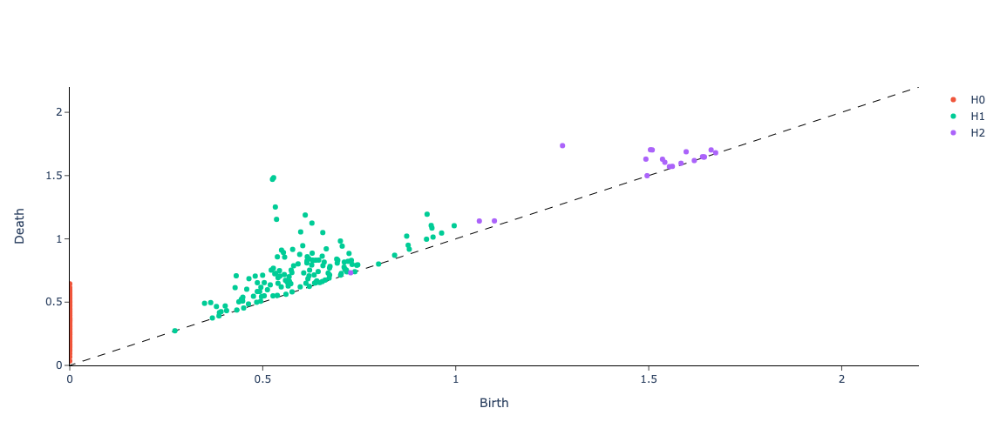

In [ ]:
# torus
plot_diagram(persistence_diagrams[-1])

### From persistent diagrams to machine learning features

Although persistence diagrams are useful descriptors of the data, they cannot be used directly for machine learning applications. This is because different persistence diagrams may have different numbers of points, and basic operations like the addition and multiplication of diagrams are not well-defined.

To overcome these limitations, a variety of proposals have been made to “vectorise” persistence diagrams via embeddings or kernels which are well-suited for machine learning. In giotto-tda, we provide access to the most common vectorisations via the `gtda.diagrams` module.

For example, one such feature is known as persistent entropy and can be applied to our diagrams as follows:

In [ ]:
persistent_entropy = PersistenceEntropy()

# calculate topological feature matrix
X = persistent_entropy.fit_transform(persistence_diagrams)

# expect shape - (n_point_clouds, n_dims)
X.shape

(30, 3)

### Train a classifier

With topological features at hand, the next step is to train a classifier. Since our dataset is small, we will use a Random Forest and make use of the OOB score to simulate accuracy on a validation set:

In [ ]:
labels.shape

(30,)

In [ ]:
data = np.concatenate((X,labels[:, None]), axis=1)

In [ ]:
np.random.shuffle(data)

In [ ]:
X, y = data[:,:3], data[:, 3]

In [ ]:
rf = RandomForestClassifier(oob_score=True)
rf.fit(X, y)
# score
rf.oob_score_

1.0

### Distance between persistence diagrams

In [ ]:
from gtda.diagrams import *

In [ ]:
dm = PairwiseDistance(n_jobs=6).fit_transform(dgms)

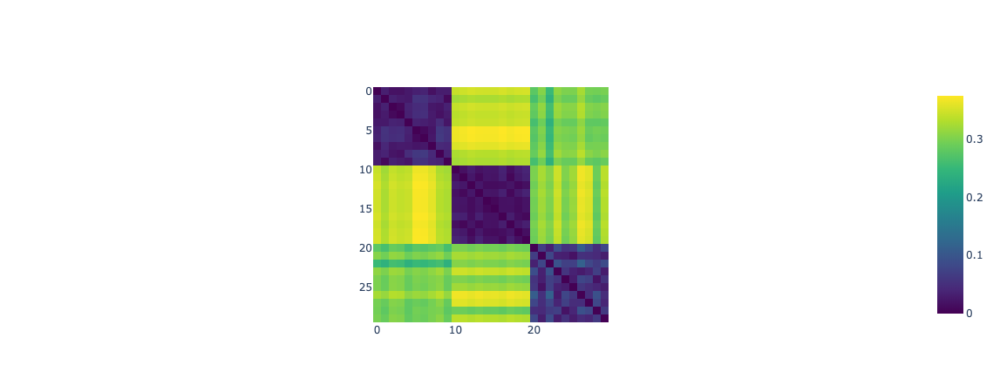

In [ ]:
plot_heatmap(dm, colorscale="viridis")

In [ ]:
from sklearn.manifold import MDS

In [ ]:
mds = MDS(n_components=3, dissimilarity="precomputed")
mds.fit_transform(dm)
XWass = mds.embedding_

In [ ]:
plot_point_cloud(XWass)

In [ ]:
point_clouds.shape

(60, 400, 3)

In [ ]:
X = point_clouds.reshape(60, 400 * 3)

In [ ]:
X.shape

(60, 1200)

In [ ]:
X = point_clouds[-1]

In [ ]:
from sklearn.decomposition import PCA

In [ ]:
pca = PCA(n_components=1)

In [ ]:
red = pca.fit_transform(X)

In [ ]:
red.shape

(400, 1)

In [ ]:
pca.components_

array([[-9.90639375e-01, -1.36503283e-01, -6.93984484e-04]])

In [ ]:
X_centered = X - np.mean(X, axis=0)
cov_matrix = np.dot(X_centered.T, X_centered) / len(X)
eigenvalues = pca.explained_variance_
for eigenvalue, eigenvector in zip(eigenvalues, pca.components_):
    print(np.dot(eigenvector.T, np.dot(cov_matrix, eigenvector)))
    print(eigenvalue)
    print(eigenvector)

2.504518211424468
2.5107951994230255
[-9.90639375e-01 -1.36503283e-01 -6.93984484e-04]
2.273613423166114
2.2793117024221705
[ 0.13650493 -0.99063232 -0.00374186]
0.48336248878324645
0.484573923592227
[ 1.76706958e-04  3.80156856e-03 -9.99992758e-01]


In [ ]:
pca.components_

array([[-9.90639375e-01, -1.36503283e-01, -6.93984484e-04],
       [ 1.36504932e-01, -9.90632324e-01, -3.74186243e-03],
       [ 1.76706958e-04,  3.80156856e-03, -9.99992758e-01]])

In [ ]:
labels

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.,
       2., 2., 2., 2., 2., 2., 2., 2., 2.])

In [ ]:
X[0]

array([-0.07373342,  1.20160489,  0.        , ..., -0.05954835,
       -0.85310849,  0.        ])

In [ ]:
X_train, X_valid, y_train, y_valid = train_test_split(X, labels, test_size=0.1)

In [ ]:
y_train.shape

(54,)

In [ ]:
rf = RandomForestClassifier().fit(X_train, y_train)

In [ ]:
rf.score(X_valid, y_valid)

1.0

In [ ]:
rf = RandomForestClassifier(oob_score=True)

In [ ]:
rf.fit(X, labels)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=True, random_state=None,
                       verbose=0, warm_start=False)

In [ ]:
rf.oob_score_

1.0

In [ ]:
plot_point_cloud(point_clouds[2])

In [ ]:
point_clouds.shape

(2, 400, 3)

## Topology of images

Do the black hole example

## Generate data

In [ ]:
circle = np.asarray([[np.sin(t), np.cos(t), 0] for t in range(400)])
plot_point_cloud(circle)

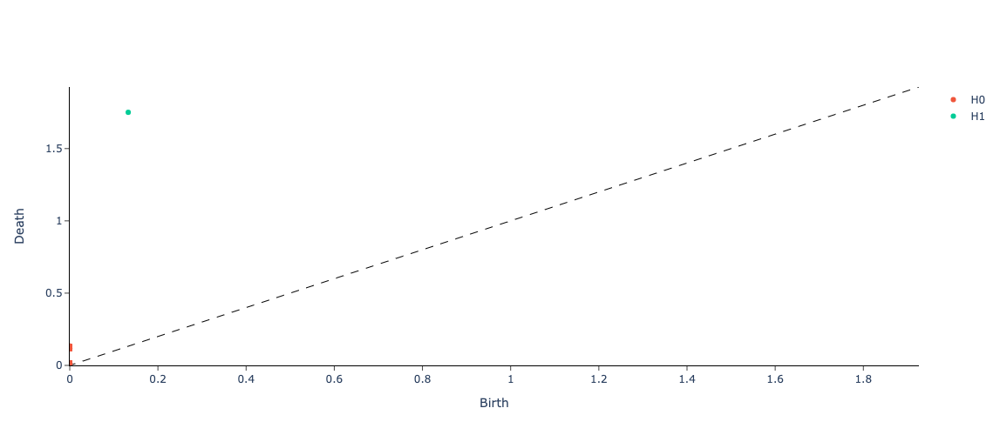

In [ ]:
vr_persistence = VietorisRipsPersistence().fit_transform_plot([circle_point_cloud])

In [ ]:
import glob

In [ ]:
DATA = Path("../data/shapes")

In [ ]:
DATA.name

'shapes'

In [ ]:
df[:3]

,x,y,z,r,g,b
0,0.315030,0.057190,0.105608,0.8,0,0
1,0.484706,0.082418,0.680499,0.8,0,0
2,0.452408,0.082418,0.498886,0.8,0,0


In [ ]:
fighters = np.asarray(
    [
        pd.read_csv(path, names=["x", "y", "z", "r", "g", "b"], usecols=["x", "y", "z"], sep=" ").sample(400).values
        for path in DATA.rglob("*.pts")
        if "fighter" in path.name
    ]
)

In [ ]:
fighters.shape

(10, 3000, 3)

In [ ]:
fighters = np.asarray(
    [
        pd.read_csv(path, names=["x", "y", "z", "r", "g", "b"], usecols=["x", "y", "z"], sep=" ").sample(400).values
        for path in DATA.rglob("*.pts")
        if "fighter" in path.name
    ]
)

In [ ]:
vases = np.asarray(
    [
        pd.read_csv(path, names=["x", "y", "z", "r", "g", "b"], usecols=["x", "y", "z"], sep=" ").sample(400).values
        for path in DATA.rglob("*.pts")
        if "vase" in path.name
    ]
)

In [ ]:
chairs = np.asarray(
    [
        pd.read_csv(path, names=["x", "y", "z", "r", "g", "b"], usecols=["x", "y", "z"], sep=" ").sample(400).values
        for path in DATA.rglob("*.pts")
        if "desk_chair" in path.name
    ]
)

In [ ]:
vases.shape

(10, 400, 3)

In [ ]:
shapes = np.concatenate((fighters, vases, chairs))

In [ ]:
shapes.shape

(30, 400, 3)

In [ ]:
X = shapes.reshape(30, 400 * 3)

In [ ]:
labels = np.zeros(30)

In [ ]:
from sklearn.datasets import make_moons

In [ ]:
X, y = make_moons()

In [ ]:
X.shape

(100, 2)

In [ ]:
y

array([1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1,
       0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0,
       0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0,
       0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0,
       1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1])

In [ ]:
labels[10:20] = 1
labels[20:] = 2

In [ ]:
rf = RandomForestClassifier(oob_score=True, random_state=42)

In [ ]:
rf.fit(X, labels)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=True, random_state=42, verbose=0,
                       warm_start=False)

In [ ]:
rf.oob_score_

0.5666666666666667

In [ ]:
labels[10:20] = 1
point_clouds = np.concatenate((chairs, vases))

In [ ]:
point_clouds.shape

(20, 400, 3)

In [ ]:
shapes = [
    "biplane",
    "desk_chair",
    "dining_chair",
    "fighter_jet",
    "fish",
    "flying_bird",
    "guitar",
    "handgun",
    "head",
    "helicopter",
    "human",
    "potted_plant",
    "race_car",
    "sedan",
    "shelves",
    "ship",
    "sword",
    "table",
    "vase",
]


def plot_shape(shape):
    print(shape)
    filename = shape + "1.pts"
    df = pd.read_csv(DATA / filename, names=["x", "y", "z", "r", "g", "b"], usecols=["x", "y", "z"], sep=" ")
    plot_point_cloud(df.values)

In [ ]:
index = 2

plot_shape(shapes[index])

dining_chair


In [ ]:
df.shape

(400, 3)

In [ ]:
from gtda.plotting import *

In [ ]:
df.iloc[:, :3]

,x,y,z
0,0.484617,0.283843,0.119897
1,0.474061,0.139316,0.138731
2,0.503646,0.335715,0.708344
3,0.486771,0.346784,0.189946
4,0.426923,0.333579,0.264974
...,...,...,...
2995,0.503844,0.169286,0.358330
2996,0.665913,0.333823,0.269720
2997,0.256557,0.330018,0.197907
2998,0.463342,0.270717,0.436645


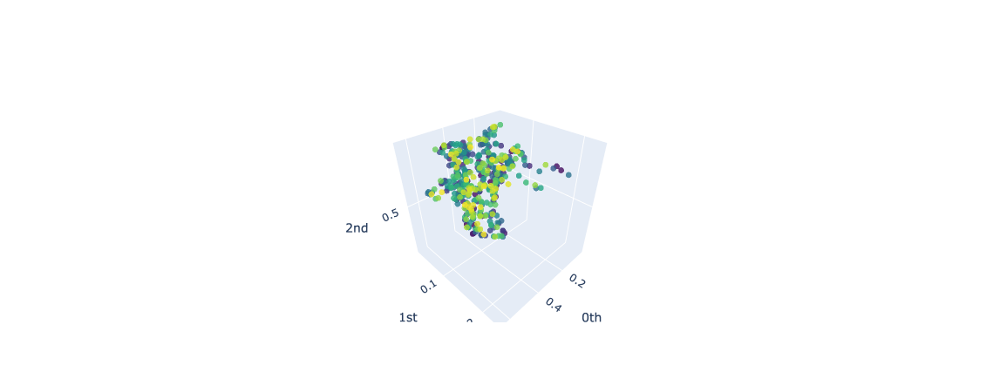

In [ ]:
plot_point_cloud(df.values)

# Generate data

Let's begin by generating 3D point clouds of spheres and tori, along with a label of 0 (1) for each sphere (torus). We also add noise to each point cloud, whose effect is to displace the points sampling the surfaces by a random amount in a random direction:

In [ ]:
point_clouds, labels = generate_point_clouds(1, 20, 0)

# check shapes
point_clouds.shape, labels.shape

((2, 400, 3), (2,))

Each point cloud corresponds to a sampling of the continuous surface - in this case 225 points are sampled per sphere or torus. As a sanity check, let's visualise these points clouds:

In [ ]:
point_clouds = chairs

In [ ]:
# expect sphere
plot_point_cloud(point_clouds[0])

In [ ]:
# expect torus
plot_point_cloud(point_clouds[-1])

# From data to persistence diagrams

The first step in our topological machine learning pipeline is to construct persistence diagrams from the training data. In giotto-tda, there are two main ways to achieve this:

* Represent the data as a _**point cloud:**_ treat each observation as a point in space, along with a metric to calculate distances between pairs of observations. In our case, the point cloud of each shape is simply the $(x,y,z)$ coordinates of each point with Euclidean distance used as the metric between any two points.
* Represent the data as a _**distance matrix:**_ calculate the pairwise distances between each observation, where “distance” does not necessarily have to be a metric. This is useful when the input data is a graph and the distance between two nodes is e.g. the number of edges along a shortest path connecting them.

For our application we will focus on point clouds, where for each point cloud our goal is to use persistent homology to generate a topological summary in the form of persistence diagrams. A fast and common way to calculate persistent homology is via the so-called [Vietoris-Rips](https://en.wikipedia.org/wiki/Vietoris%E2%80%93Rips_complex) complex. The mathematical details are not important for this example, rather the main idea is that we instantiate the class `VietorisRipsPersistence` just like a scikit-learn estimator and then make use of the fit-transform paradigm to generate the diagrams:

In [ ]:
persistence = VietorisRipsPersistence()
persistence_dgms = persistence.fit_transform(point_clouds)

In [ ]:
point_clouds[-2:].shape

(2, 3000, 3)

In [ ]:
# track connected components, loops, and voids
homology_dimensions = [0, 1, 2]

persistence = VietorisRipsPersistence(metric="euclidean", homology_dimensions=homology_dimensions, n_jobs=6)

%time persistence_diagrams = persistence.fit_transform(shapes)

CPU times: user 71.5 ms, sys: 10.8 ms, total: 82.3 ms
Wall time: 1min 25s


Once we have computed our persistence diagrams, we can compare how the sphere and torus produce different patterns at each homology dimension:

In [ ]:
persistence_diagrams.shape

(30, 551, 3)

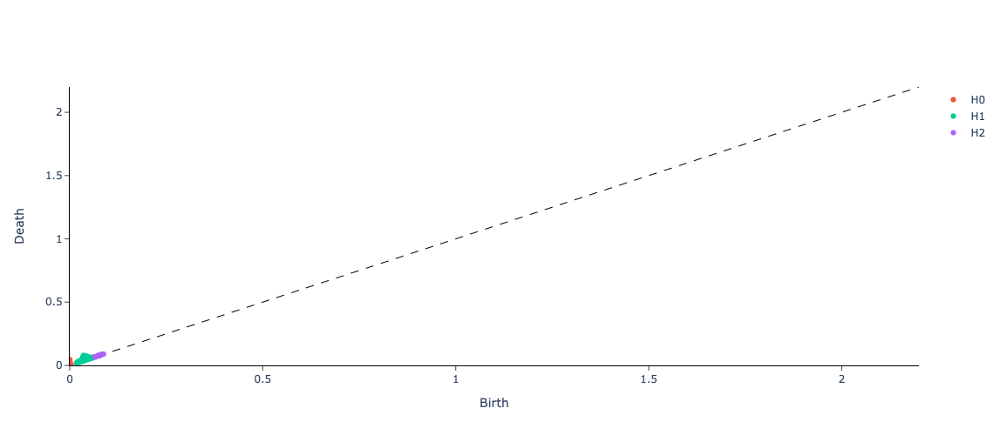

In [ ]:
# sphere
plot_diagram(persistence_diagrams[0])

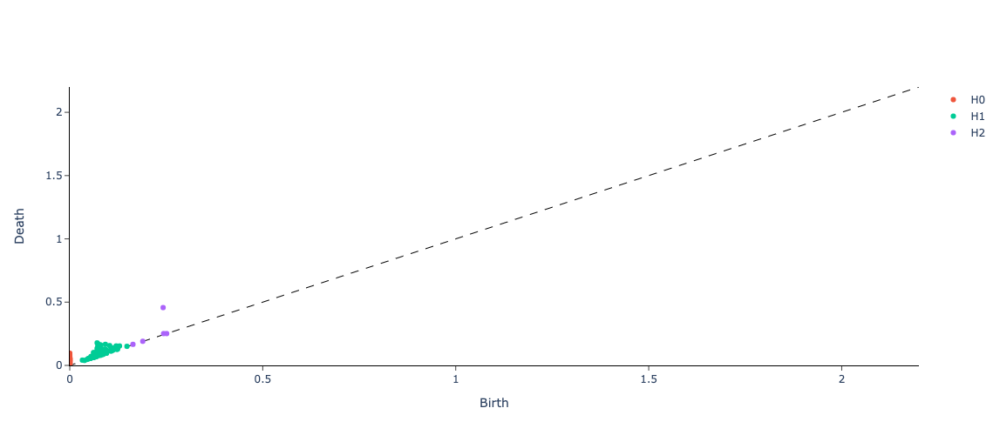

In [ ]:
# sphere
plot_diagram(persistence_diagrams[11])

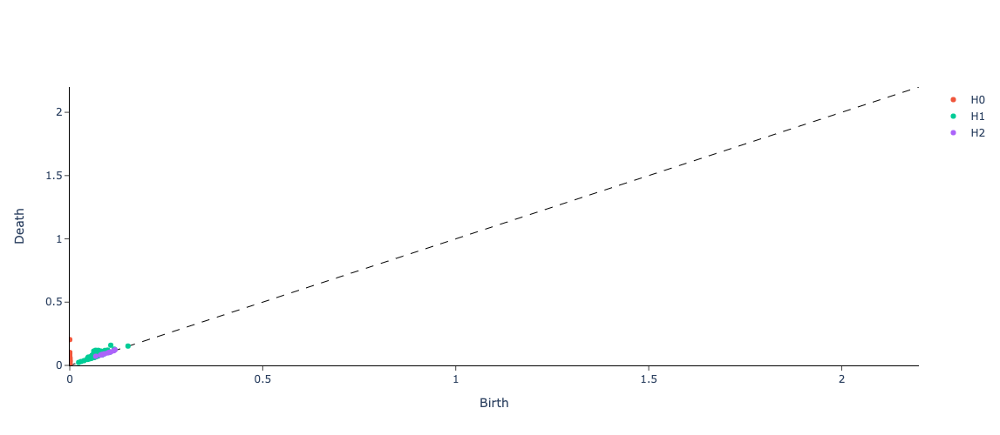

In [ ]:
# torus
plot_diagram(persistence_diagrams[-1])

Notice the presence of a persistent void (H2) in the case of the sphere, and the presence of persistent loops (H1) in the case of the torus.

# From persistent diagrams to machine learning features

Although persistence diagrams are useful descriptors of the data, they cannot be used directly for machine learning applications. This is because different persistence diagrams may have different numbers of points, and basic operations like the addition and multiplication of diagrams are not well-defined.

To overcome these limitations, a variety of proposals have been made to “vectorise” persistence diagrams via embeddings or kernels which are well-suited for machine learning. In giotto-tda, we provide access to the most common vectorisations via the `gtda.diagrams` module.

For example, one such feature is known as persistent entropy and can be applied to our diagrams as follows:

In [ ]:
persistent_entropy = PersistenceEntropy()
features = persistent_entropy.fit_transform(persistence_dgms)

NameError: name 'persistence_dgms' is not defined

In [ ]:
persistent_entropy = PersistenceEntropy()

# calculate topological feature matrix
X = persistent_entropy.fit_transform(persistence_diagrams)

# expect shape - (n_point_clouds, n_dims)
X.shape

(30, 3)

In [ ]:
X[0]

array([5.87698451, 4.10437732, 2.58995554])

# Train a model

With topological features at hand, the next step is to train a classifier. Since `X` is just like any feature matrix, we can create a train and validation set a usual:

In [ ]:
labels = np.zeros(20)

In [ ]:
labels[10:] = 1

In [ ]:
labels

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 2., 2., 2., 2., 2., 2., 2., 2., 2., 2.])

In [ ]:
X_train, X_valid, y_train, y_valid = train_test_split(X, labels)

The final step is to train and score a model - let's use a Random Forest and evaluate the accuracy of our predictions on the validation set:

In [ ]:
rf = RandomForestClassifier(oob_score=True)
rf.fit(X, labels)
# score

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=True, random_state=None,
                       verbose=0, warm_start=False)

In [ ]:
rf.oob_score_

0.4666666666666667

It works!

In [ ]:
rf = RandomForestClassifier()

In [ ]:
cross_val_score(rf, X_train, y_train)

array([0.33333333, 0.        , 0.33333333, 0.        , 1.        ])

In [ ]:
ts = np.load("data1samp-1.npy")

In [ ]:
ts["data"].shape

(11, 16384)

In [ ]:
ts.shape

(11,)

In [ ]:
ts[0][5].shape

(16384,)

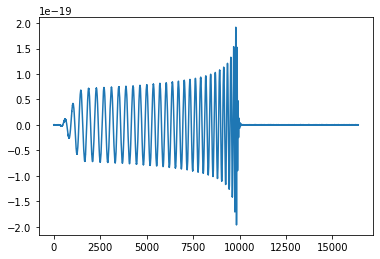

In [ ]:
plt.plot(ts[9][5])

In [ ]:
def padrand(V, n, kr):
    cut = np.random.randint(n)
    rand1 = np.random.randn(cut)
    rand2 = np.random.randn(n - cut)
    out = np.concatenate((rand1 * kr, V, rand2 * kr))
    return out

In [ ]:
RN = 20  # this is the number of SNR values generated
Rcoef = np.linspace(0.075, 0.65, RN)
Npad = 2000  # number of padding points on either side of the vector
gw = np.load("data1samp-1.npy")
Norig = len(gw["data"][0])
Ndat = len(gw["signal_present"])
ri = []
k = 0
nsamp = 2  # downsampling value, 2 means divide the sample rate by 2
N = int(Norig / nsamp)

Ndattotal = 100  # number of data elements to generate
ncoeff = []
Rcoeflist = []
for j in range(Ndattotal):
    ncoeff.append(10 ** (-19) * (1 / Rcoef[j % RN]))
    Rcoeflist.append(Rcoef[j % RN])
x = []
xsig = []
y = []
pcloud = []
maxs = 0.0
k = 0
y = np.zeros((Ndattotal, 2))
for j in range(Ndattotal):
    signal = gw["data"][j % Ndat][range(0, Norig, nsamp)]
    sigp = int((np.random.randn() < 0))
    noise = ncoeff[j] * np.random.randn(N)
    y[j, 0] = sigp
    y[j, 1] = 1 - sigp
    if sigp == 1:
        rawsig = padrand(signal + noise, Npad, ncoeff[j])
        # generate the actual synthetic raw
        # by adding noise and padding with noise
        if k == 0:
            k = 1
    else:
        rawsig = padrand(noise, Npad, ncoeff[j])

In [ ]:
rawsig.shape

(10192,)

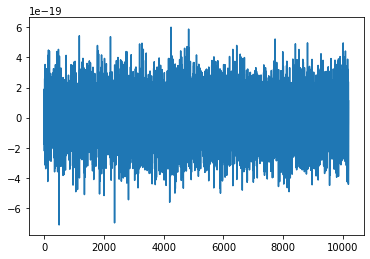

In [ ]:
plt.plot(rawsig)

## Images

In [ ]:
from PIL import Image
from gtda.images import *

In [ ]:
cells_original = Image.open("../data/Cells.jpg").convert("L")

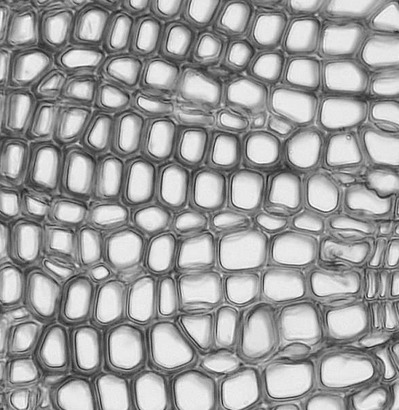

In [ ]:
cells_original

In [ ]:
from scipy import sparse

In [ ]:
def lower_star_img(img):
    """
    Construct a lower star filtration on an image
    Parameters
    ----------
    img: ndarray (M, N)
        An array of single channel image data
    Returns
    -------
    I: ndarray (K, 2)
        A 0-dimensional persistence diagram corresponding to the sublevelset filtration
    """
    m, n = img.shape

    idxs = np.arange(m * n).reshape((m, n))

    I = idxs.flatten()
    J = idxs.flatten()
    V = img.flatten()

    # Connect 8 spatial neighbors
    tidxs = np.ones((m + 2, n + 2), dtype=np.int64) * np.nan
    tidxs[1:-1, 1:-1] = idxs

    tD = np.ones_like(tidxs) * np.nan
    tD[1:-1, 1:-1] = img

    for di in [-1, 0, 1]:
        for dj in [-1, 0, 1]:

            if di == 0 and dj == 0:
                continue

            thisJ = np.roll(np.roll(tidxs, di, axis=0), dj, axis=1)
            thisD = np.roll(np.roll(tD, di, axis=0), dj, axis=1)
            thisD = np.maximum(thisD, tD)

            # Deal with boundaries
            boundary = ~np.isnan(thisD)
            thisI = tidxs[boundary]
            thisJ = thisJ[boundary]
            thisD = thisD[boundary]

            I = np.concatenate((I, thisI.flatten()))
            J = np.concatenate((J, thisJ.flatten()))
            V = np.concatenate((V, thisD.flatten()))

    sparseDM = sparse.coo_matrix((V, (I, J)), shape=(idxs.size, idxs.size))
    return sparseDM

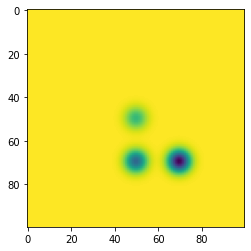

In [ ]:
ts = np.linspace(-1, 1, 100)
x1 = np.exp(-(ts ** 2) / (0.1 ** 2))
ts -= 0.4
x2 = np.exp(-(ts ** 2) / (0.1 ** 2))
img = -x1[None, :] * x1[:, None] - 2 * x1[None, :] * x2[:, None] - 3 * x2[None, :] * x2[:, None]
plt.imshow(img)
plt.show()

In [ ]:
dm = lower_star_img(img)

In [ ]:
vr_persistence = VietorisRipsPersistence(metric="precomputed", homology_dimensions=[0], n_jobs=6, infinity_values=0.5)

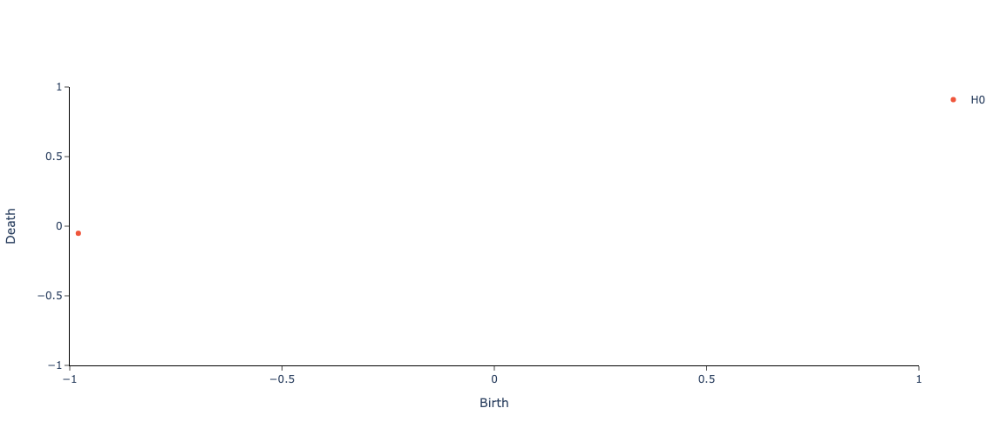

In [ ]:
dgms = vr_persistence.fit_transform_plot(dm.toarray()[None, :, :])

In [ ]:
import PIL

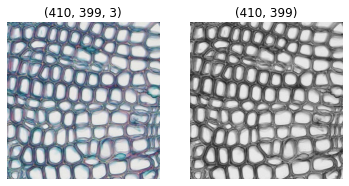

In [ ]:
cells_original = plt.imread("../data/Cells.jpg")
cells_grey = np.asarray(PIL.Image.fromarray(cells_original).convert("L"))

plt.subplot(121)
plt.title(cells_original.shape)
plt.imshow(cells_original)
plt.axis("off")
plt.subplot(122)
plt.title(cells_grey.shape)
plt.imshow(cells_grey, cmap="gray")
plt.axis("off")
plt.show()

In [ ]:
dm = lower_star_img(-cells_grey)

In [ ]:
dm.toarray().shape

(163590, 163590)

In [ ]:
vr_persistence = VietorisRipsPersistence(metric="precomputed", homology_dimensions=[0], n_jobs=3)
dgms = vr_persistence.fit_transform_plot(dm.toarray()[None, :, :])

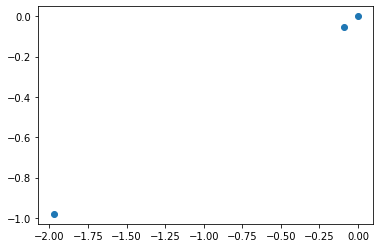

In [ ]:
plt.scatter(dgms[:, 0], dgms[:, 1])

In [ ]:
dgms

array([[[-1.97244036, -0.0894627 ,  0.        ],
        [-0.97980124, -0.05095871,  0.        ]]])

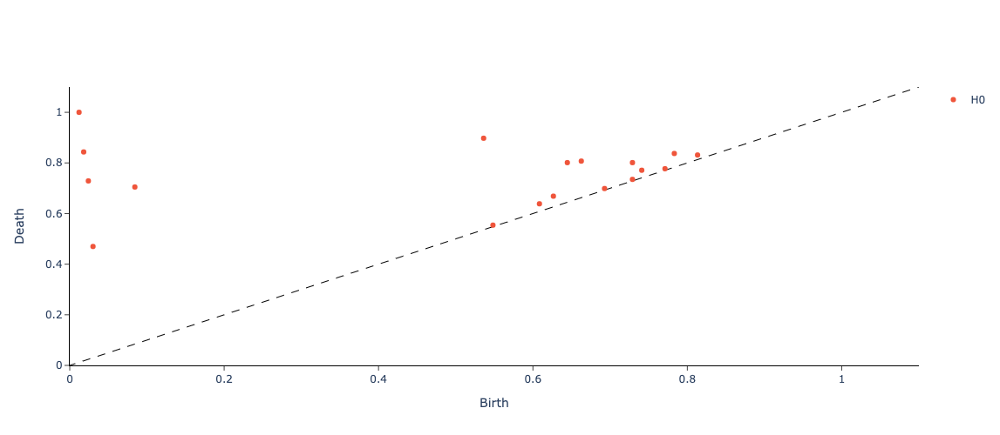

In [ ]:
cb = CubicalPersistence(homology_dimensions=[0, 1]).fit_transform_plot(np.array(cells_grey))

In [ ]:
cb.shape

(1, 19, 3)

In [ ]:
from scipy import ndimage

In [ ]:
# Normalize to the range [0, 1]
cells_grey = -ndimage.uniform_filter(cells_original, size=10)
cells_grey = cells_grey - np.min(cells_grey)
cells_grey = cells_grey / np.max(cells_grey)

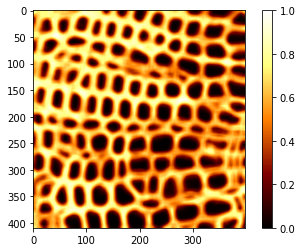

In [ ]:
plt.imshow(cells_grey, cmap="afmhot")
plt.colorbar()

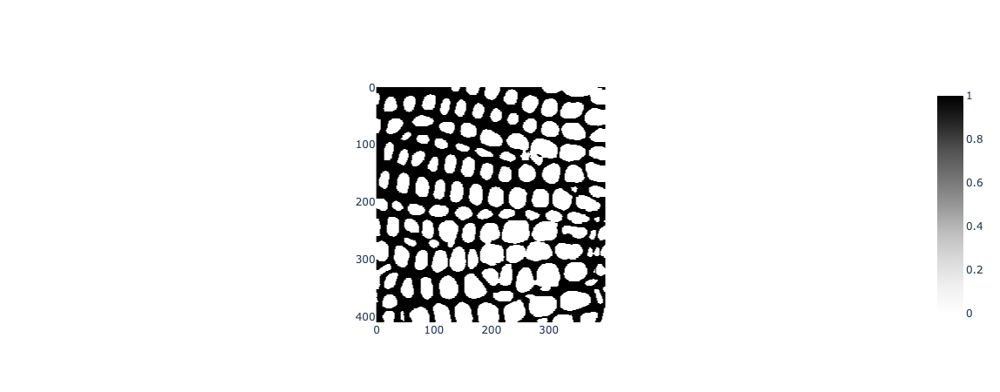

In [ ]:
binary = Binarizer(threshold=0.5)
cells_binary = binary.fit_transform_plot(cells_grey[None, :, :])

In [ ]:
cells_binary

array([[[ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        ...,
        [ True,  True,  True, ..., False, False, False],
        [ True,  True,  True, ..., False, False, False],
        [ True,  True,  True, ..., False, False, False]]])

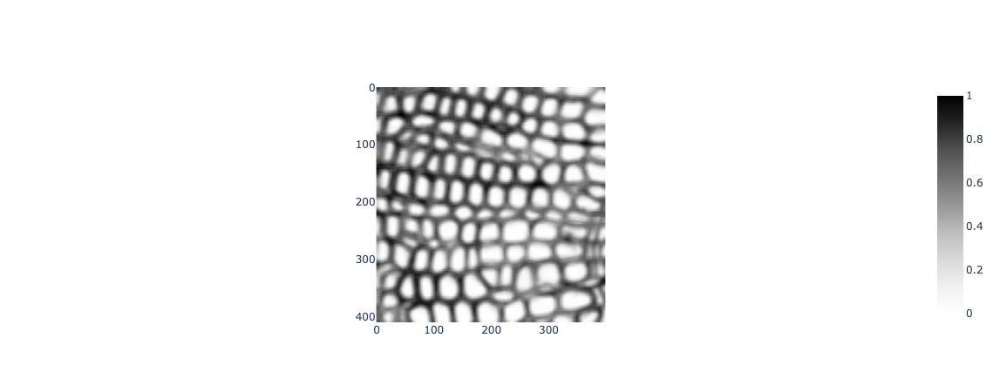

In [ ]:
plot_heatmap(cells_grey)

In [ ]:
cells_grey

array([[0.79518072, 0.79518072, 0.79518072, ..., 0.6626506 , 0.6746988 ,
        0.68674699],
       [0.79518072, 0.79518072, 0.79518072, ..., 0.64457831, 0.6686747 ,
        0.68072289],
       [0.81325301, 0.81325301, 0.80722892, ..., 0.62048193, 0.64457831,
        0.6626506 ],
       ...,
       [0.73493976, 0.74096386, 0.74698795, ..., 0.21686747, 0.1686747 ,
        0.13253012],
       [0.72289157, 0.73493976, 0.74096386, ..., 0.20481928, 0.15662651,
        0.12650602],
       [0.71084337, 0.71686747, 0.72891566, ..., 0.19277108, 0.14457831,
        0.11445783]])

In [ ]:
-np.ones(2)

array([-1., -1.])

In [ ]:
hf = HeightFiltration(np.array([-1, -1]))

In [ ]:
cells_grey[None, :, :].shape

(1, 410, 399)

In [ ]:
hf.fit_transform(cells_binary)
;

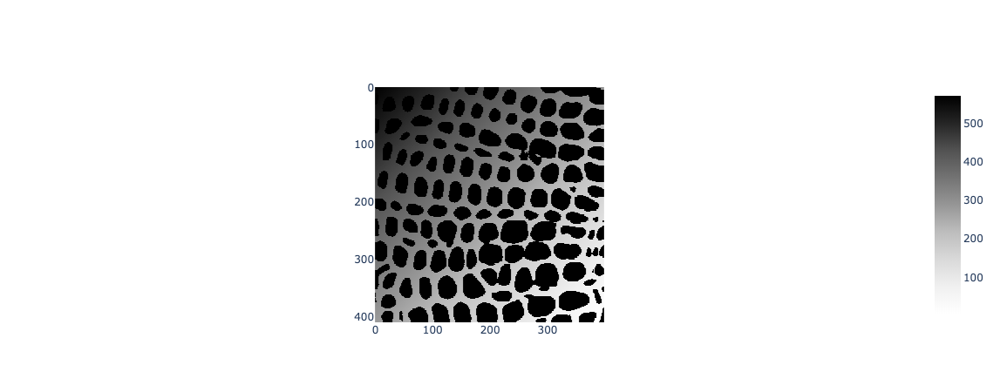

In [ ]:
filtration = hf.fit_transform_plot(cells_binary)
;

In [ ]:
filtration.shape

(1, 410, 399)

In [ ]:
filtration[0].shape

(350, 640)

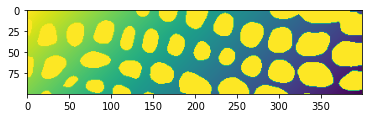

In [ ]:
plt.imshow(filtration[0][:100])

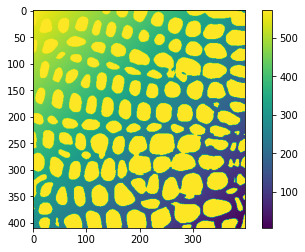

In [ ]:
plt.imshow(filtration[0], cmap="viridis")
plt.colorbar()
;

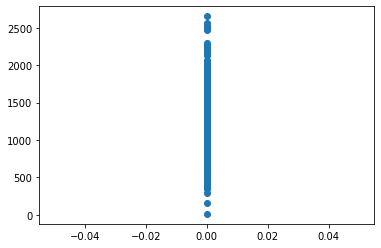

In [ ]:
plt.scatter(persistence_diagrams[0][:, 0], persistence_diagrams[0][:, 1])

In [ ]:
filtration.shape

(1, 410, 399)

In [ ]:
I.shape

(409, 3)

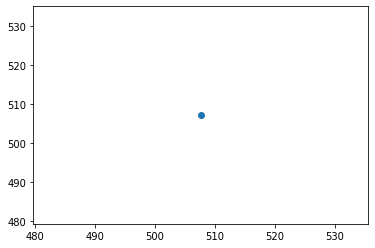

In [ ]:
plt.scatter(np.mean(filtration[0][0]), np.mean(filtration[0][1]))

In [ ]:
filtration[0].shape

(410, 399)

In [ ]:
# track connected components, loops, and voids
homology_dimensions = [0]

persistence = VietorisRipsPersistence(metric="euclidean", homology_dimensions=homology_dimensions, n_jobs=6)

%time persistence_diagrams = persistence.fit_transform(filtration)

CPU times: user 22.8 ms, sys: 39.8 ms, total: 62.6 ms
Wall time: 859 ms


In [ ]:
persistence_diagrams[0]

array([[   0.        ,   10.90871239,    0.        ],
       [   0.        ,  157.79792786,    0.        ],
       [   0.        ,  284.19393921,    0.        ],
       ...,
       [   0.        , 2518.76904297,    0.        ],
       [   0.        , 2564.03466797,    0.        ],
       [   0.        , 2655.41650391,    0.        ]])

In [ ]:
I = persistence_diagrams[0]
# I = I[I[:, 1]-I[:, 0] > 0.001, :]

In [ ]:
Inorm = (I - np.min(I)) / np.max(I)

In [ ]:
Inorm

array([[0.        , 0.0041081 , 0.        ],
       [0.        , 0.05942493, 0.        ],
       [0.        , 0.10702424, 0.        ],
       ...,
       [0.        , 0.9485401 , 0.        ],
       [0.        , 0.96558663, 0.        ],
       [0.        , 1.        , 0.        ]])

In [ ]:
I.shape

(409, 3)

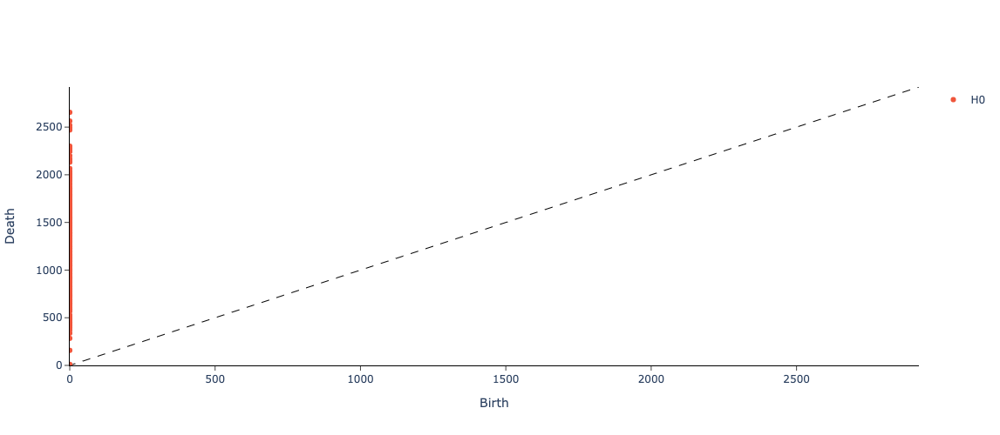

In [ ]:
plot_diagram(I)

In [ ]:
cells_binary.shape

(1, 410, 399)

In [ ]:
F = cells_grey + 0.001 * np.random.randn(cells_grey.shape[0], cells_grey.shape[1])
# I = HeightFiltration(direction=-np.ones(2)).fit_transform(F[None, :, :])
# I = I[I[:, :, 1]-I[:, :, 0] > 0.001, :] # Filter out low persistence values

In [ ]:
X, Y = np.meshgrid(np.arange(F.shape[1]), np.arange(F.shape[0]))
X = X.flatten()
Y = Y.flatten()

In [ ]:
Inorm.shape

(409, 3)

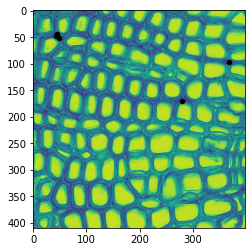

In [ ]:
fig, ax = plt.subplots()

cutoff = 0.9
idxs = np.arange(Inorm.shape[0])
idxs = idxs[Inorm[:, 1] > cutoff]
ax.imshow(cells_original)

for idx in idxs:
    bidx = np.argmin(np.abs(F - Inorm[idx, 1]))
    ax.scatter(X[bidx], Y[bidx], 20, "k")

In [ ]:
I[0]

array([ 0.        , 10.90871239,  0.        ])

In [ ]:
I.shape

(409, 3)

In [ ]:
idxs.shape

(388,)

In [ ]:
F.shape

(410, 399)

In [ ]:
I[0]

array([ 0.        , 10.90871239,  0.        ])

In [ ]:
I[1]

array([  0.        , 157.79792786,   0.        ])

In [ ]:
np.max(F)

0.9999729974637193

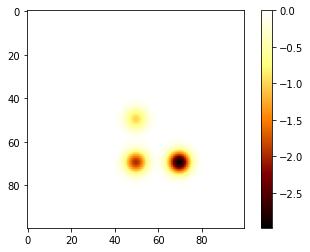

In [ ]:
plt.figure()
ts = np.linspace(-1, 1, 100)
x1 = np.exp(-(ts ** 2) / (0.1 ** 2))
ts -= 0.4
x2 = np.exp(-(ts ** 2) / (0.1 ** 2))

# Define depths of Gaussian blobs
h1 = -1
h2 = -2
h3 = -3
img = h1 * x1[None, :] * x1[:, None] + h2 * x1[None, :] * x2[:, None] + h3 * x2[None, :] * x2[:, None]
plt.imshow(img, cmap="afmhot")
plt.colorbar()
plt.show()

In [ ]:
img_scaled = (img - np.min(img)) / (np.max(img) - np.min(img))

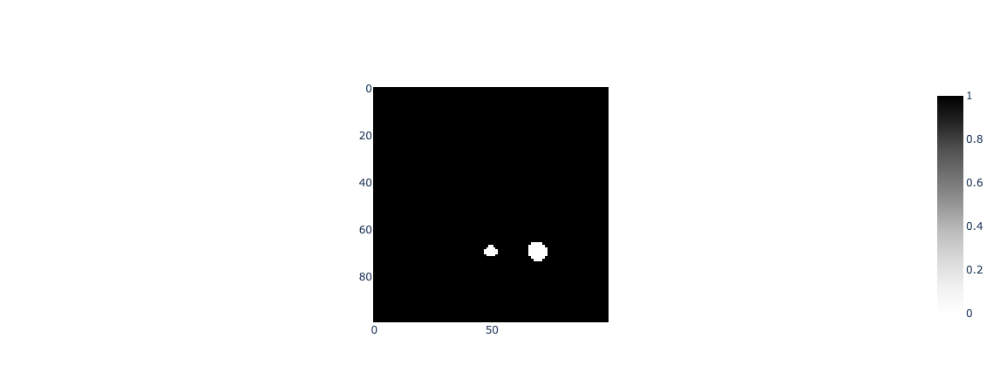

In [ ]:
img_bin = Binarizer().fit_transform_plot(img_scaled[None, :, :])

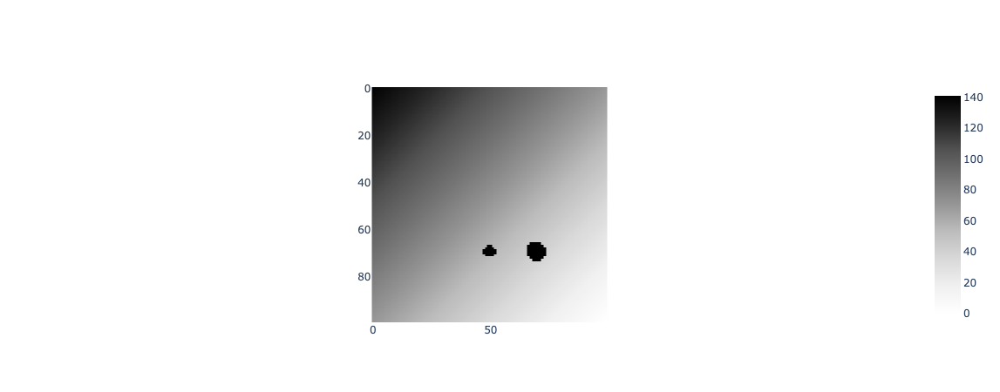

In [ ]:
filtration = HeightFiltration(np.array([-1, -1])).fit_transform_plot(img_bin)

In [ ]:
filtration.shape

(1, 100, 100)

/usr/local/anaconda3/envs/hepml/lib/python3.7/site-packages/gtda/homology/simplicial.py:177: DataDimensionalityWarning:

Input array X has X.shape[1] == X.shape[2]. This is consistent with a collection of distance/adjacency matrices, but the input is being treated as a collection of vectors in Euclidean space.

/usr/local/anaconda3/envs/hepml/lib/python3.7/site-packages/gtda/homology/simplicial.py:228: DataDimensionalityWarning:

Input array X has X.shape[1] == X.shape[2]. This is consistent with a collection of distance/adjacency matrices, but the input is being treated as a collection of vectors in Euclidean space.



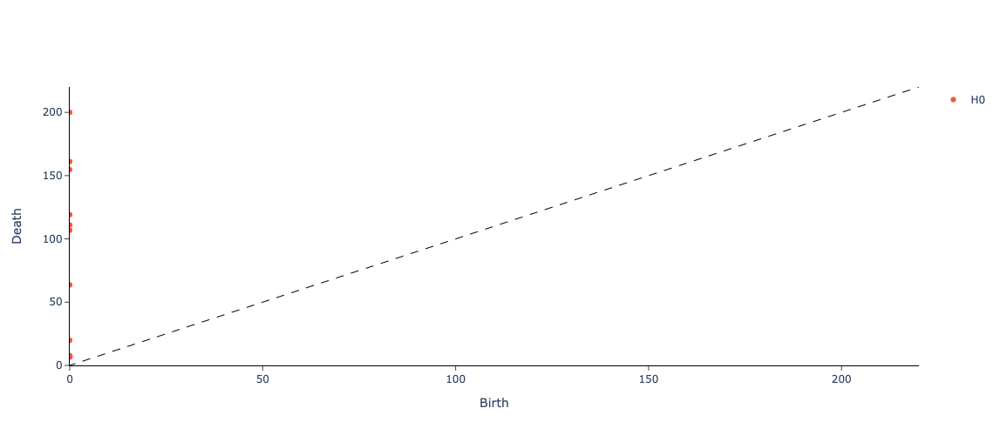

In [ ]:
dgms = VietorisRipsPersistence(homology_dimensions=[0, 1]).fit_transform_plot(filtration)

In [ ]:
from gtda.diagrams import *

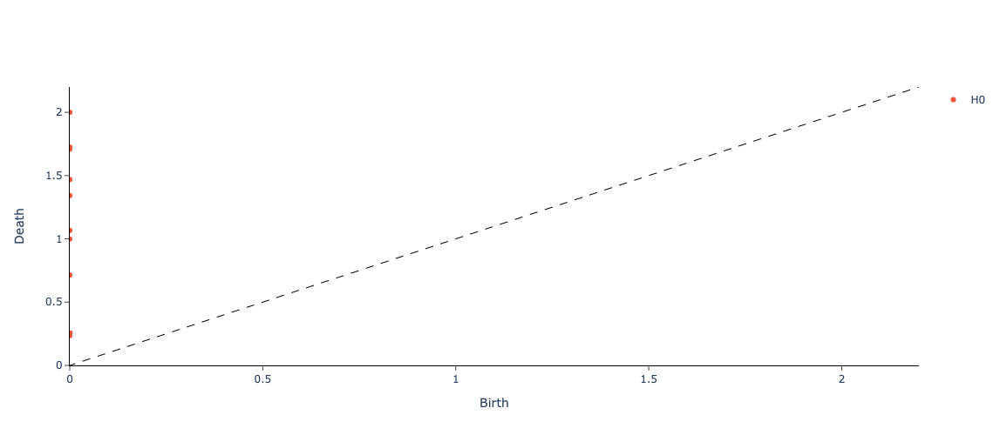

In [ ]:
Scaler().fit_transform_plot(dgms)
;